## Auto-Regressive Model

An auto-regressive model is a simple model that predicts future performance based on past performance. It is mainly used for forecasting when there is some correlation between values in a given time series and the values that precede and succeed (back and forth).

An AR model is a Linear Regression model that uses lagged variables as input. The Linear Regression model can be easily built using the scikit-learn library by indicating the input. Statsmodels library is used to provide autoregression model-specific functions where you have to specify an appropriate lag value and train the model. It is provided in the AutoTeg class to get the results using simple steps.

Creating the model AutoReg()
Call fit() to train it on our dataset.
Returns an AutoRegResults object.
Once fit, make a prediction by calling the predict () function

The equation for the AR model (Let’s compare Y=mX+c)


In [1]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels as sm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.ar_model import AutoReg

# from statsmodels.tsa.ar_model import AutoReg

#from cleanup import clean_data
#from engineer import feature_engineer

plt.rcParams['figure.figsize'] = (14,6)
plt.rcParams['font.size'] = '14'

## Step 1) Load the data - IMPORTANT: remainder! (not the absolute number)

In [2]:
df = pd.read_csv('df_remainder_yearly.csv',  index_col=0, parse_dates=True)
# Set figure size to (14,6)



In [3]:
df.columns

Index(['remainder'], dtype='object')

In [4]:
# Plot the data
def plot_remainder(df, 
                   title='Remaining Passenger Number after Extracting Trend and Seasonality'):
    '''
    Custom plotting function for plotting the flights dataset
    
    Parameters
    ----------
    df : pd.DataFrame
        The data to plot.
    title : str
        The title of the plot
    
    Returns
    -------
    Plots the data
    '''
    
    df.plot()
    plt.title(title)
    plt.ylabel('# of Passengers in 1000')
    plt.show()

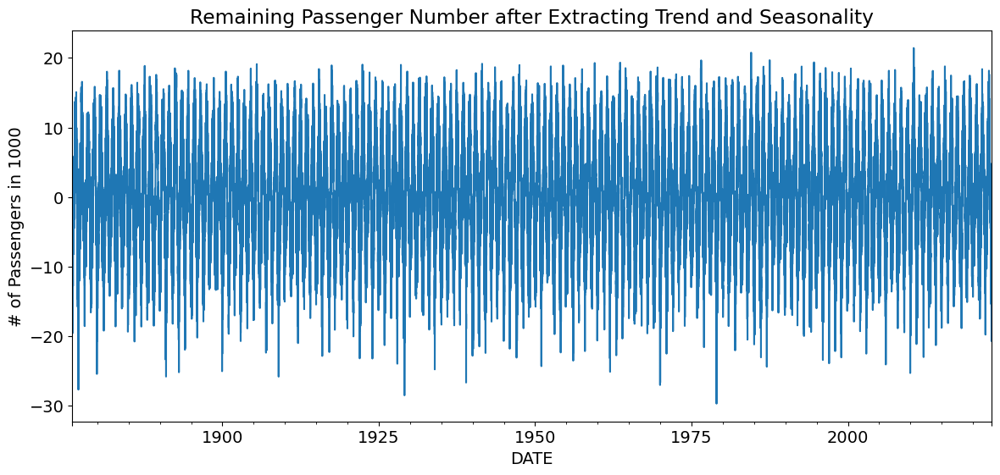

In [5]:
plot_remainder(df['remainder'])

In [6]:
import plotly.express as px
px.scatter(df['remainder'])

## Step 2) Create a time-lagged input feature: lag1

A lag is an interval of time between related phenomena. The two related phenomena in this case are the remainder today and the remainder yesterday.


In [7]:
df

,remainder
DATE,
1876-01-01,-4.570127
1876-01-02,-4.284100
1876-01-03,-6.498073
1876-01-04,-12.612047
1876-01-05,-16.626020
...,...
2022-12-27,-9.871596
2022-12-28,-7.785569
2022-12-29,-4.099542


In [8]:
df['lag1'] = df['remainder'].shift(1)

df

,remainder,lag1
DATE,,
1876-01-01,-4.570127,NaN
1876-01-02,-4.284100,-4.570127
1876-01-03,-6.498073,-4.284100
1876-01-04,-12.612047,-6.498073
1876-01-05,-16.626020,-12.612047
...,...,...
2022-12-27,-9.871596,-4.557623
2022-12-28,-7.785569,-9.871596
2022-12-29,-4.099542,-7.785569


## Step 3) Inspect correlations

In [9]:
df.corr()

,remainder,lag1
remainder,1.000000,0.951377
lag1,0.951377,1.000000


### Intuitively

    If it was warm yesterday, it is more likely to be warm today

    If there were a lot of passengers last month we expect a lot of passengers this month



### Step  4) Plot remainder against lag1

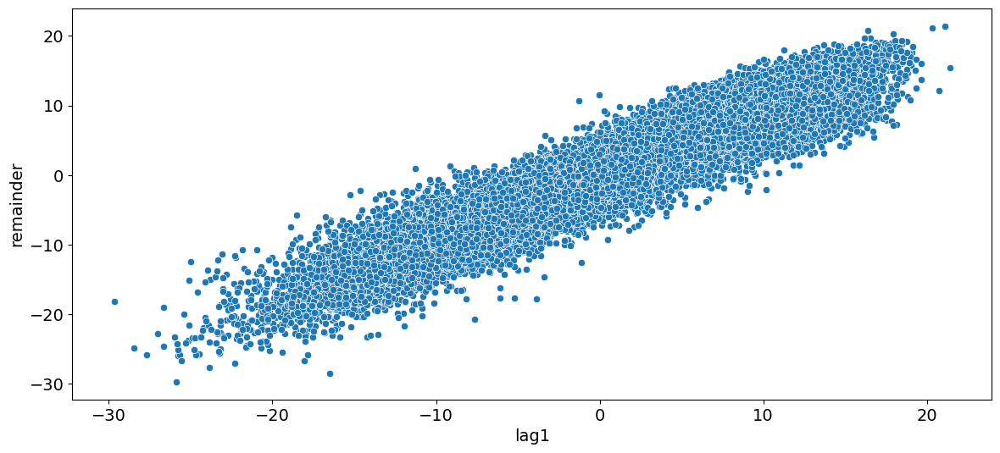

In [10]:
sns.scatterplot(x='lag1', y='remainder', data=df);

Looks as if we could to some degree predict y (remainder) using x (lag1) by creating a linear regression:
$$y = w x + c + \epsilon$$

## The Autoregressive Model (AR)

Now we are ready to talk about the autoregressive model. In the autoregressive model, we model the **future** value of a variable by looking at the **present** (and maybe past) value of the same variable. In our case the variable will be the **remainder**.

$$
\hat{y}_{t} = w_0 + \sum_{j=1}^{p}w_{j}y_{t-j} + \epsilon_{t}
$$


where $t$ is the current timestep, $w_0$ is the bias/intercept (constant), the w’s are the weights of the model and $\epsilon$ is some **iid** (independent and identically distributed random variable, e.g. Gaussian - more on this tomorrow) noise. **p** is the number of lags to use for the model. It is a hyperparameter that we have to choose.

**AR(1) - Model**

$$
\hat{y}_{t} = w_0 + w_1 * y_{t-1} + \epsilon_{t}
$$

which we can write as

$$
\hat{y}_{t+1} = w_0 + w_1 * y_{t} + \epsilon_{t+1}
$$

or in case of our remainder

$$
\hat{remainder}_{t+1} = w_0 + w_1 * remainder_{t} + \epsilon_{t+1}
$$

In an AR(1) model we model the value in $t+1$ as a linear function of the y value in $t$.

**AR(2) - Model**

$$
\hat{y}_{t+1} = w_0 + w_1 * y_{t} + w_2 * y_{t-1} + \epsilon_{t+1}
$$

### Step 5) Run an Autoregression (Linear Regression) of lag1 on the remainder

In [11]:
# Drop missing values
df.dropna(inplace=True)
df.head()

,remainder,lag1
DATE,,
1876-01-02,-4.284100,-4.570127
1876-01-03,-6.498073,-4.284100
1876-01-04,-12.612047,-6.498073
1876-01-05,-16.626020,-12.612047
1876-01-06,-14.539993,-16.626020


In [12]:
# Assign X and y
X = df[['lag1']]
y = df['remainder']

In [13]:
# Create and fit the model
m = LinearRegression()
m.fit(X, y)

LinearRegression()

In [14]:
# Create predictions
df['predictions_ar1'] = m.predict(X)
df.head()

,remainder,lag1,predictions_ar1
DATE,,,
1876-01-02,-4.284100,-4.570127,-4.347804
1876-01-03,-6.498073,-4.284100,-4.075685
1876-01-04,-12.612047,-6.498073,-6.182002
1876-01-05,-16.626020,-12.612047,-11.998678
1876-01-06,-14.539993,-16.626020,-15.817468


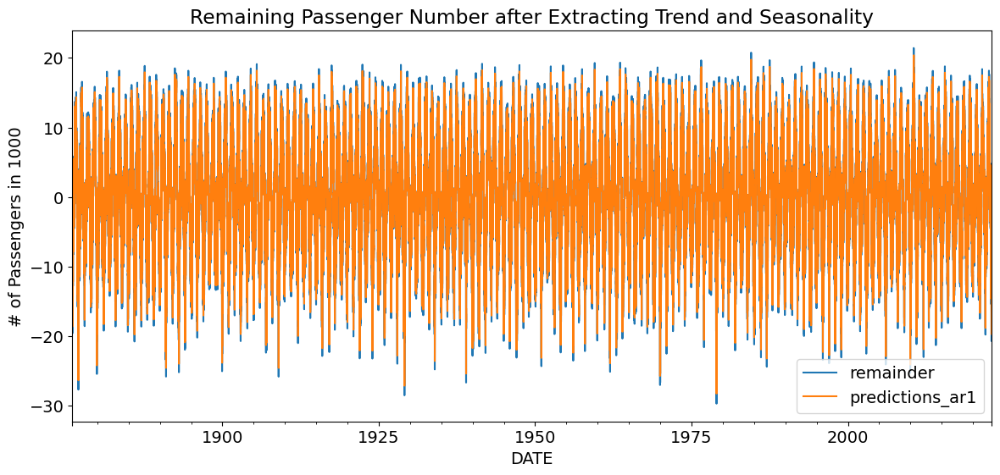

In [15]:
# Plot the original remainder and the prediction
plot_remainder(df[['remainder', 'predictions_ar1']])

In [16]:
px.scatter(df[['remainder', 'predictions_ar1']])

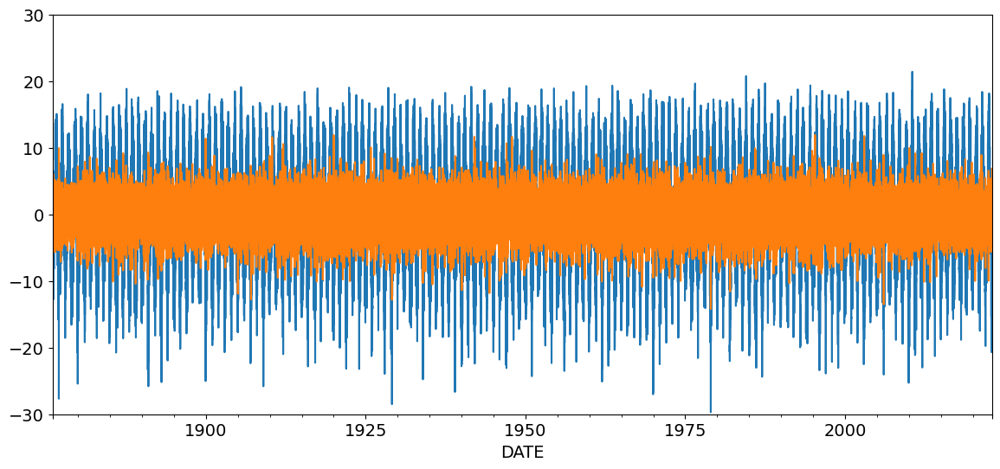

In [17]:
# Is the remainder prediction error smaller than the remainder itself?
df['remainder'].plot(ylim=[-30,30])
(df['remainder'] - df['predictions_ar1']).plot(ylim=[-30,30]);

Seems sensible to use a lag: range of y-values has about halved.

### Step 6) Should we add another lag (lag2)?

In [18]:
df['lag2'] = df['remainder'].shift(2)
df['lag3'] = df['remainder'].shift(3)

df.head()

,remainder,lag1,predictions_ar1,lag2,lag3
DATE,,,,,
1876-01-02,-4.284100,-4.570127,-4.347804,NaN,NaN
1876-01-03,-6.498073,-4.284100,-4.075685,NaN,NaN
1876-01-04,-12.612047,-6.498073,-6.182002,-4.284100,NaN
1876-01-05,-16.626020,-12.612047,-11.998678,-6.498073,-4.284100
1876-01-06,-14.539993,-16.626020,-15.817468,-12.612047,-6.498073


In [19]:
round(df[['remainder', 'lag1', 'lag2','lag3']].corr(), 2)

,remainder,lag1,lag2,lag3
remainder,1.00,0.95,0.90,0.87
lag1,0.95,1.00,0.95,0.90
lag2,0.90,0.95,1.00,0.95
lag3,0.87,0.90,0.95,1.00


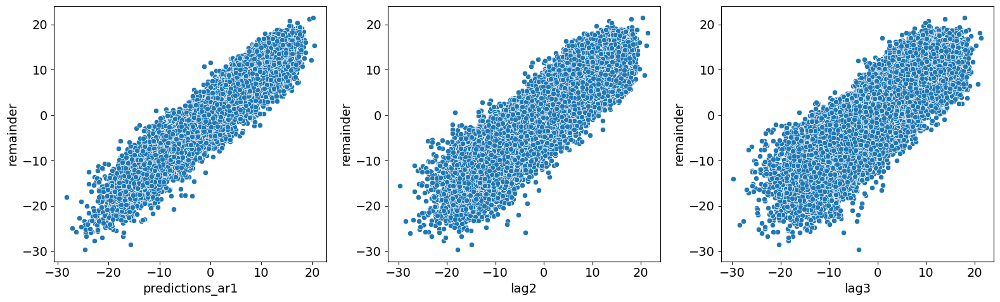

In [20]:
import matplotlib.gridspec as gridspec
#sns.set() # set seaborn as default style
p=3
lag_columns = df.columns[-p:]
fig, axes = plt.subplots(1,p, figsize=(16,5),dpi=100)
gs = gridspec.GridSpec(1,p)

for i in range(p):
    sns.scatterplot(x=df[lag_columns[i]],y=df['remainder'],ax=axes[i])
    
plt.tight_layout()

As there is some correlation between lag2 and remainder (0.6), it would at first sight seem sensible to add lag2 as well. However, we have already used lag1 to make some predictions on the remainder and should not look at lag2 versus remainder but on lag2 versus the unexplained "remainder of the remainder". Or in other words:

The relation between the remainder and lag2 might just be due to the relation between the remainder and lag1 and the relation between lag1 and lag2.


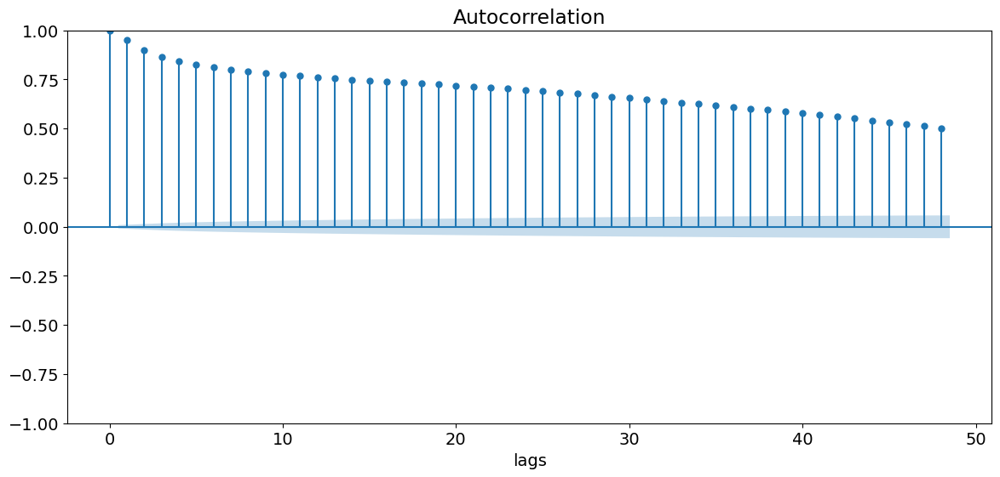

In [21]:
from statsmodels.graphics.tsaplots import plot_acf
plot_acf(df['remainder'])
plt.xlabel('lags');

Let's have a look at the different Autocorrelations

In [22]:
# white noise or random noise
import numpy as np
random_array = np.random.normal(loc=0, scale=10, size=53690)
df['random'] = random_array

<AxesSubplot: xlabel='DATE'>

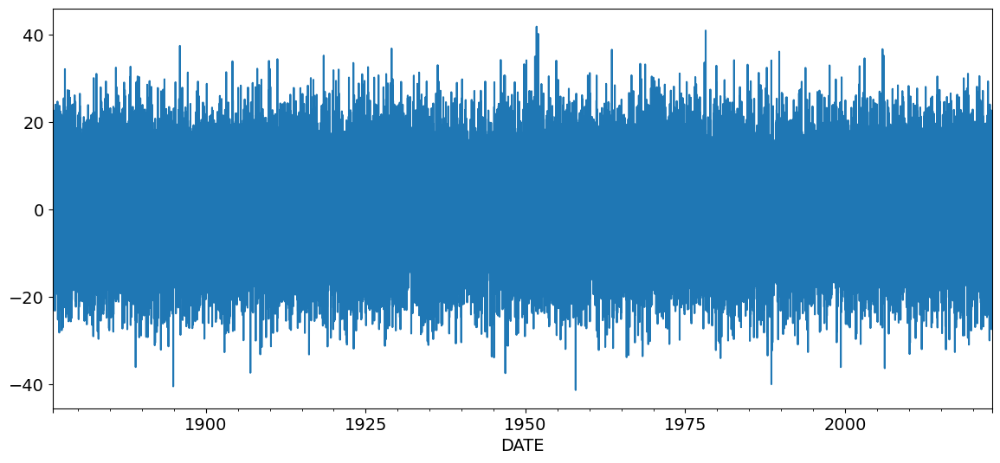

In [23]:
df['random'].plot()

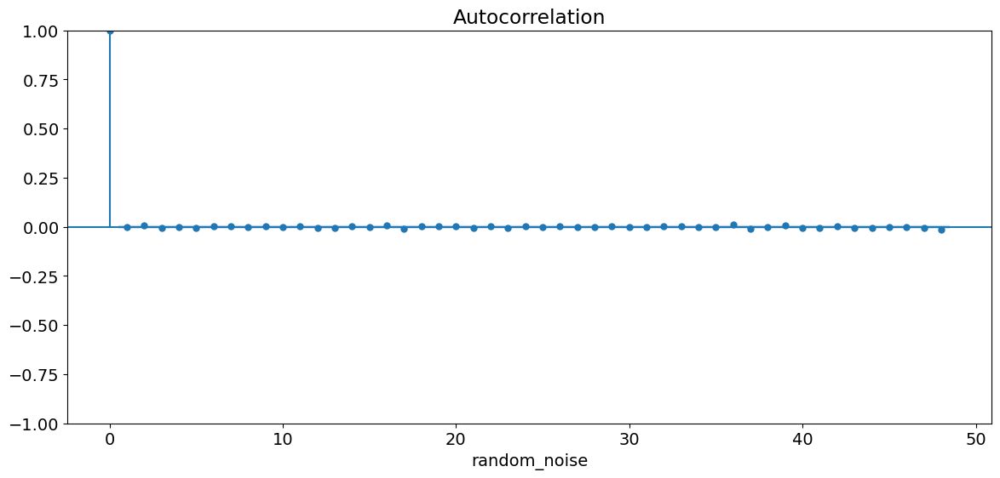

In [24]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
plot_acf(df['random'])
plt.xlabel('random_noise');

Autocorrelations do not provide an obvious way as to how many lags to use. Therefore:

### Step 6.1) Determine _Partial_ Autocorrelation

#### One tool to find out how many lags we should include in our Autoregressive Model is to plot the **Partial** Autocorrelation between different lags. What is partial Autocorrelation?

$$
\delta_h = Corr(y_t, y_{t-h}|y_{t-1}, ..., y_{t-h+1})
$$

PACF is the correlation between $y_t$ and $y_{t−h}$, conditional on the intermediate values (eg. $y_{t-1}$, $y_{t-2}$, ...). 

They are basically nothing else than the coefficients in a linear regression if you included h lags

C:\Users\ReDI\anaconda3\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



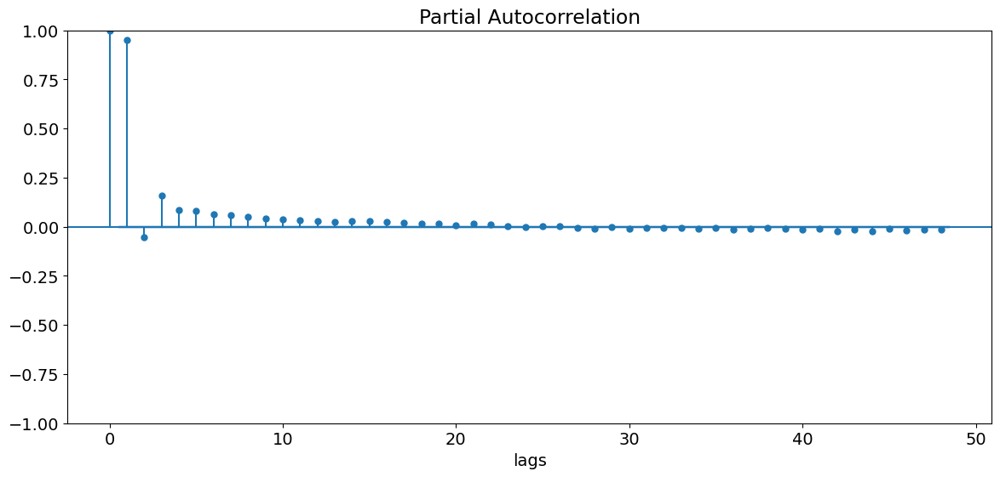

In [25]:
# Statsmodels provides a function called plot_pacf
# plot partial autocorrelation function
from statsmodels.graphics.tsaplots import plot_pacf
plot_pacf(df['remainder'])
plt.xlabel('lags');

### Box-Jenkins-Methodology

This methodology makes a statement about how to choose lags.

We will choose all lags until the first sharp drop in values. In this case we should use 1 lag. This is the point after which we know the correlation dropped significantly.


In [26]:
from statsmodels.tsa.ar_model import ar_select_order


In [27]:
lags_order = ar_select_order(df['remainder'], maxlag=5)

C:\Users\ReDI\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\ReDI\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



In [28]:
lags_order.ar_lags

[1, 2, 3, 4, 5]

In [29]:
lags_order.bic

{(1, 2, 3, 4, 5): 242634.68729081828,
 (1, 2, 3, 4): 242963.58488081486,
 (1, 2, 3): 243344.50433039464,
 (1, 2): 244692.32482288356,
 (1,): 244832.20878333584,
 0: 371256.89150581777}

In [30]:
import statsmodels.api as sm
from pylab import rcParams

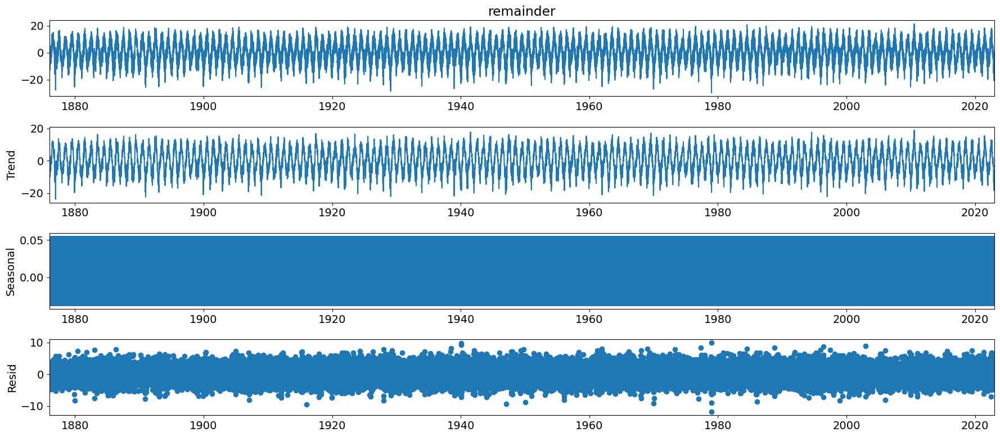

In [31]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()